In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [177]:
raw_flight_data = pd.read_csv('../Project1_Resources/three_quarters_mci_data.csv')
raw_flight_data.head()

,Month,DayofMonth,DayOfWeek,Marketing_Airline_Network,Origin,OriginCityName,Dest,DestCityName,DepDelayMinutes,ArrDelayMinutes,Cancelled,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",38.0,46.0,0.0,0.0,0.0,46.0,0.0,0.0
1,1,10,4,UA,ORD,"Chicago, IL",MCI,"Kansas City, MO",60.0,48.0,0.0,48.0,0.0,0.0,0.0,0.0
2,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",11.0,20.0,0.0,0.0,0.0,9.0,0.0,11.0
3,1,11,5,AS,SFO,"San Francisco, CA",MCI,"Kansas City, MO",0.0,55.0,0.0,0.0,0.0,55.0,0.0,0.0
4,1,11,5,AS,SAN,"San Diego, CA",MCI,"Kansas City, MO",0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN


In [178]:
df = raw_flight_data.copy()

In [179]:
dep_delay_df= df.loc[df['DepDelayMinutes']>0]
dep_delay_df

,Month,DayofMonth,DayOfWeek,Marketing_Airline_Network,Origin,OriginCityName,Dest,DestCityName,DepDelayMinutes,ArrDelayMinutes,Cancelled,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",38.0,46.0,0.0,0.0,0.0,46.0,0.0,0.0
1,1,10,4,UA,ORD,"Chicago, IL",MCI,"Kansas City, MO",60.0,48.0,0.0,48.0,0.0,0.0,0.0,0.0
2,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",11.0,20.0,0.0,0.0,0.0,9.0,0.0,11.0
8,1,11,5,DL,LGA,"New York, NY",MCI,"Kansas City, MO",65.0,47.0,0.0,0.0,0.0,13.0,0.0,34.0
9,1,11,5,DL,MSP,"Minneapolis, MN",MCI,"Kansas City, MO",1.0,10.0,0.0,NaN,NaN,NaN,NaN,NaN
10,1,11,5,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",3.0,44.0,0.0,0.0,0.0,41.0,0.0,3.0
24,1,18,5,AS,SEA,"Seattle, WA",MCI,"Kansas City, MO",14.0,17.0,0.0,0.0,14.0,3.0,0.0,0.0
31,1,22,2,AS,SEA,"Seattle, WA",MCI,"Kansas City, MO",5.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
33,1,23,3,AS,SEA,"Seattle, WA",MCI,"Kansas City, MO",10.0,3.0,0.0,NaN,NaN,NaN,NaN,NaN
37,1,25,5,AS,SEA,"Seattle, WA",MCI,"Kansas City, MO",12.0,9.0,0.0,NaN,NaN,NaN,NaN,NaN


In [180]:
arr_delay_df = df.loc[df['ArrDelayMinutes']>0]
arr_delay_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 27635 entries, 0 to 84825
Data columns (total 16 columns):
Month                        27635 non-null int64
DayofMonth                   27635 non-null int64
DayOfWeek                    27635 non-null int64
Marketing_Airline_Network    27635 non-null object
Origin                       27635 non-null object
OriginCityName               27635 non-null object
Dest                         27635 non-null object
DestCityName                 27635 non-null object
DepDelayMinutes              27635 non-null float64
ArrDelayMinutes              27635 non-null float64
Cancelled                    27635 non-null float64
CarrierDelay                 14899 non-null float64
WeatherDelay                 14899 non-null float64
NASDelay                     14899 non-null float64
SecurityDelay                14899 non-null float64
LateAircraftDelay            14899 non-null float64
dtypes: float64(8), int64(3), object(5)
memory usage: 3.6+ MB


In [181]:
dayofweek_delay=dep_delay_df[['DayOfWeek','DepDelayMinutes']]
dayofweek_arr_delay = arr_delay_df[['DayOfWeek','ArrDelayMinutes']]
groupby_arr_delay = dayofweek_arr_delay.groupby('DayOfWeek').count()

test_df=dayofweek_delay.groupby('DayOfWeek').sum()
test2_df = dayofweek_delay.groupby('DayOfWeek').count()
groupby_arr_delay


,ArrDelayMinutes
DayOfWeek,
1,4051
2,3739
3,4105
4,4559
5,4452
6,2804
7,3925


In [182]:
arr_total = df.loc[df['Dest']=='MCI']
dep_total = df.loc[df['Origin']=='MCI']

arr_total_df = arr_total[['DayOfWeek','Dest']]
dep_total_df = dep_total[['DayOfWeek','Origin']]

arr_total_df_gb = arr_total_df.groupby('DayOfWeek').count()
dep_total_df_gb = dep_total_df.groupby('DayOfWeek').count()
arr_total_df_gb

,Dest
DayOfWeek,
1,6469
2,6308
3,6389
4,6404
5,6464
6,4436
7,5958


Text(0, 0.5, 'Percentage Delay (%)')

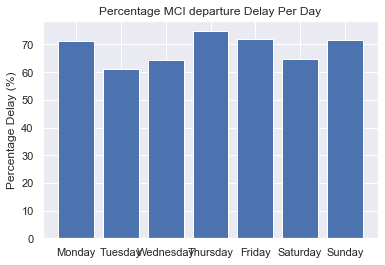

In [8]:
days=['Monday','Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
fig1=plt.bar(days,test2_df['DepDelayMinutes']/dep_total_df_gb['Origin']*100)
plt.title('Percentage MCI departure Delay Per Day')
plt.ylabel('Percentage Delay (%)')


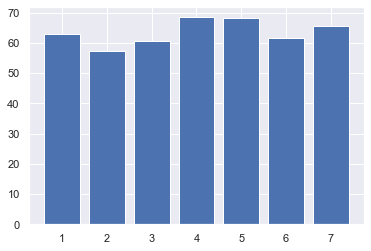

In [9]:
fig2 = plt.bar(test_df.index,groupby_arr_delay['ArrDelayMinutes']/arr_total_df_gb['Dest']*100)

In [10]:
airport_delay=arr_delay_df[['Origin','ArrDelayMinutes']]
df_airports_origin_delay_sum = airport_delay.groupby('Origin').sum()
df_airports_origin_delay_count = airport_delay.groupby('Origin').count()
df_airports_origin_delay_count
df_airports_origin_total = arr_total[['Origin','Dest']].groupby('Origin').count()
df_airports_origin_delay_count = df_airports_origin_delay_count.drop(['MCI'])
df_airports_origin_delay_count.count()
df_airports_origin_total
# pd.merge(df_airports_origin_delay_count, df_airports_origin_total, on='Origin', how='outer')

,Dest
Origin,
ABQ,250
ATL,3000
AUS,257
AZA,27
BNA,900
BOS,623
BWI,677
CLT,1031
CVG,399


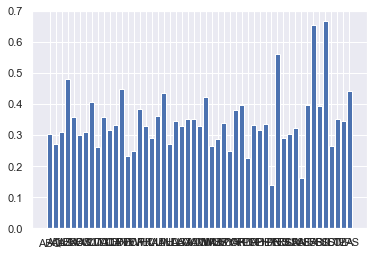

In [11]:
fig3 = plt.bar(df_airports_origin_delay_count.index,df_airports_origin_delay_count['ArrDelayMinutes']/df_airports_origin_total['Dest'],)

## weather delays and airports
##### months, weather delay, aiport

In [13]:
df

,Month,DayofMonth,DayOfWeek,Marketing_Airline_Network,Origin,OriginCityName,Dest,DestCityName,DepDelayMinutes,ArrDelayMinutes,Cancelled,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
0,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",38.0,46.0,0.0,0.0,0.0,46.0,0.0,0.0
1,1,10,4,UA,ORD,"Chicago, IL",MCI,"Kansas City, MO",60.0,48.0,0.0,48.0,0.0,0.0,0.0,0.0
2,1,10,4,UA,SFO,"San Francisco, CA",MCI,"Kansas City, MO",11.0,20.0,0.0,0.0,0.0,9.0,0.0,11.0
3,1,11,5,AS,SFO,"San Francisco, CA",MCI,"Kansas City, MO",0.0,55.0,0.0,0.0,0.0,55.0,0.0,0.0
4,1,11,5,AS,SAN,"San Diego, CA",MCI,"Kansas City, MO",0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
5,1,11,5,DL,MSP,"Minneapolis, MN",MCI,"Kansas City, MO",0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
6,1,11,5,DL,MSP,"Minneapolis, MN",MCI,"Kansas City, MO",0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
7,1,11,5,DL,LGA,"New York, NY",MCI,"Kansas City, MO",0.0,7.0,0.0,NaN,NaN,NaN,NaN,NaN
8,1,11,5,DL,LGA,"New York, NY",MCI,"Kansas City, MO",65.0,47.0,0.0,0.0,0.0,13.0,0.0,34.0
9,1,11,5,DL,MSP,"Minneapolis, MN",MCI,"Kansas City, MO",1.0,10.0,0.0,NaN,NaN,NaN,NaN,NaN


In [183]:
arr_weather_delay = arr_delay_df.loc[arr_delay_df['WeatherDelay']>0]
arr_weather_delay 

,Month,DayofMonth,DayOfWeek,Marketing_Airline_Network,Origin,OriginCityName,Dest,DestCityName,DepDelayMinutes,ArrDelayMinutes,Cancelled,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay
24,1,18,5,AS,SEA,"Seattle, WA",MCI,"Kansas City, MO",14.0,17.0,0.0,0.0,14.0,3.0,0.0,0.0
187,1,21,1,DL,SLC,"Salt Lake City, UT",MCI,"Kansas City, MO",168.0,188.0,0.0,0.0,147.0,20.0,0.0,21.0
232,1,23,3,DL,MSP,"Minneapolis, MN",MCI,"Kansas City, MO",52.0,37.0,0.0,0.0,37.0,0.0,0.0,0.0
241,1,23,3,DL,DTW,"Detroit, MI",MCI,"Kansas City, MO",136.0,142.0,0.0,0.0,136.0,6.0,0.0,0.0
303,1,29,2,UA,IAD,"Washington, DC",MCI,"Kansas City, MO",28.0,62.0,0.0,0.0,62.0,0.0,0.0,0.0
324,1,18,5,UA,IAD,"Washington, DC",MCI,"Kansas City, MO",998.0,989.0,0.0,0.0,989.0,0.0,0.0,0.0
329,1,30,3,UA,IAD,"Washington, DC",MCI,"Kansas City, MO",769.0,783.0,0.0,0.0,783.0,0.0,0.0,0.0
356,1,13,7,UA,IAD,"Washington, DC",MCI,"Kansas City, MO",223.0,224.0,0.0,0.0,224.0,0.0,0.0,0.0
422,1,12,6,UA,ORD,"Chicago, IL",MCI,"Kansas City, MO",43.0,92.0,0.0,0.0,43.0,49.0,0.0,0.0
437,1,18,5,AA,MIA,"Miami, FL",MCI,"Kansas City, MO",684.0,684.0,0.0,0.0,684.0,0.0,0.0,0.0


In [184]:
arr_weather_delay = arr_weather_delay[['Month','Origin','OriginCityName','WeatherDelay']]
arr_weather_delay = arr_weather_delay.loc[arr_weather_delay['Origin']!= 'MCI']
arr_weather_delay

,Month,Origin,OriginCityName,WeatherDelay
24,1,SEA,"Seattle, WA",14.0
187,1,SLC,"Salt Lake City, UT",147.0
232,1,MSP,"Minneapolis, MN",37.0
241,1,DTW,"Detroit, MI",136.0
303,1,IAD,"Washington, DC",62.0
324,1,IAD,"Washington, DC",989.0
329,1,IAD,"Washington, DC",783.0
356,1,IAD,"Washington, DC",224.0
422,1,ORD,"Chicago, IL",43.0
437,1,MIA,"Miami, FL",684.0


In [185]:
new = arr_weather_delay['OriginCityName'].str.split(", ",n = 1, expand = True )

In [186]:
arr_weather_delay['State']=new[1]
arr_weather_delay

,Month,Origin,OriginCityName,WeatherDelay,State
24,1,SEA,"Seattle, WA",14.0,WA
187,1,SLC,"Salt Lake City, UT",147.0,UT
232,1,MSP,"Minneapolis, MN",37.0,MN
241,1,DTW,"Detroit, MI",136.0,MI
303,1,IAD,"Washington, DC",62.0,DC
324,1,IAD,"Washington, DC",989.0,DC
329,1,IAD,"Washington, DC",783.0,DC
356,1,IAD,"Washington, DC",224.0,DC
422,1,ORD,"Chicago, IL",43.0,IL
437,1,MIA,"Miami, FL",684.0,FL


In [187]:
west=['WA','OR','CA','NV','ID','UT','MT','WY','CO']
midwest=['ND','SD','NE','KS','MN','IA','MO','WI','IL','MI','IN','OH']
southwest=['AZ','NM','TX','OK']
southeast = ['AR','LA','MS','KY','TN','AL','GA','FL','SC','NC','VA','WV','DC']
northeast = ['ME','VT','NY','NH','MA','RI','CT','NJ','DE','MD','PA']
arr_weather_delay['Region']=arr_weather_delay['State']
arr_weather_delay.reset_index(drop = True)
new = arr_weather_delay.copy().set_index('State')
pd.options.mode.chained_assignment = None
pd.set_option('display.max_rows', None)
new

,Month,Origin,OriginCityName,WeatherDelay,Region
State,,,,,
WA,1,SEA,"Seattle, WA",14.0,WA
UT,1,SLC,"Salt Lake City, UT",147.0,UT
MN,1,MSP,"Minneapolis, MN",37.0,MN
MI,1,DTW,"Detroit, MI",136.0,MI
DC,1,IAD,"Washington, DC",62.0,DC
DC,1,IAD,"Washington, DC",989.0,DC
DC,1,IAD,"Washington, DC",783.0,DC
DC,1,IAD,"Washington, DC",224.0,DC
IL,1,ORD,"Chicago, IL",43.0,IL


In [188]:

for row in new.index:
    if str(row) in west:
        new.loc[row,'Region'] = 'west'
    elif str(row) in midwest:
        new.loc[row,'Region'] = 'midwest'
    elif str(row) in southeast:
        new.loc[row,'Region'] = 'southeast'
    elif str(row) in southwest:
        new.loc[row,'Region'] = 'southwest'
    elif str(row) in northeast:
        new.loc[row,'Region'] = 'northeast'
        
new.info()

<class 'pandas.core.frame.DataFrame'>
Index: 487 entries, WA to FL
Data columns (total 5 columns):
Month             487 non-null int64
Origin            487 non-null object
OriginCityName    487 non-null object
WeatherDelay      487 non-null float64
Region            487 non-null object
dtypes: float64(1), int64(1), object(3)
memory usage: 32.8+ KB


In [91]:
new

,Month,Origin,OriginCityName,WeatherDelay,Region
State,,,,,
WA,1,SEA,"Seattle, WA",14.0,west
UT,1,SLC,"Salt Lake City, UT",147.0,west
MN,1,MSP,"Minneapolis, MN",37.0,midwest
MI,1,DTW,"Detroit, MI",136.0,midwest
DC,1,IAD,"Washington, DC",62.0,southeast
DC,1,IAD,"Washington, DC",989.0,southeast
DC,1,IAD,"Washington, DC",783.0,southeast
DC,1,IAD,"Washington, DC",224.0,southeast
IL,1,ORD,"Chicago, IL",43.0,midwest


<Figure size 432x288 with 0 Axes>

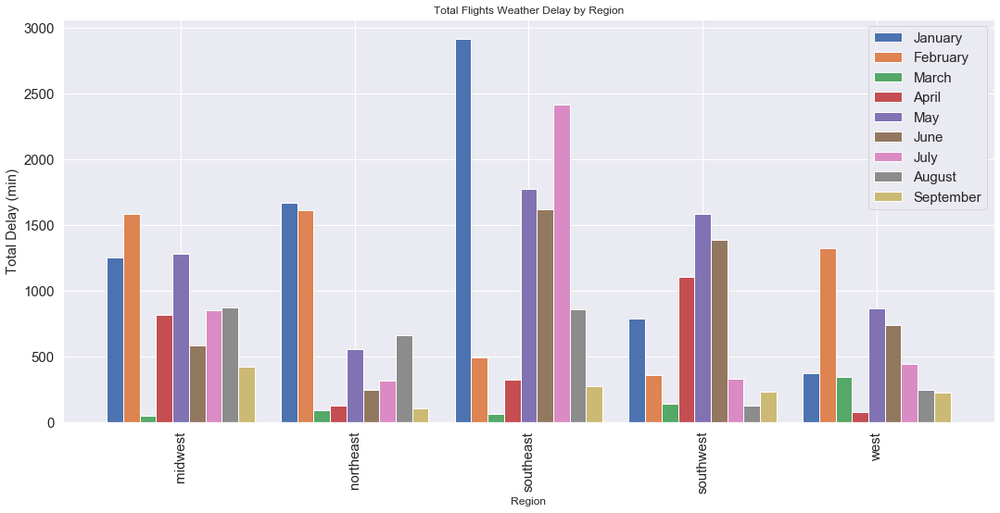

In [225]:
new_gb = new.groupby('Month')
new_gb.sum()
# new_gb.sum().plot.bar(subplots=True)
new_df = new_gb
fig, ax = plt.subplots(0)
ax = new.groupby(['Month','Region']).sum().unstack(0).plot(kind='bar',figsize=(18,8),legend=False,title='Total Flights Weather Delay by Region',fontsize=15, width=0.85)
# ax.legend=['1','2','3','4','5','6','7','8','9']
# labels = ax.get_legend_handles_labels()
# ax.legend(labels, loc='best')
ax.set_ylabel('Total Delay (min)',fontsize=15)
# plt.legend(ax[:8],['1','2','3','4','5','6','7','8','9'])
h,l = ax.get_legend_handles_labels()
ax.legend(h[:9],[ 'January', 'February', 'March', 'April','May', 'June', 'July', 'August', 'September'], loc='best', fontsize=15)
figure = ax.get_figure()
figure.savefig("Total_Flights_Weather_Delay_by_Region.png")


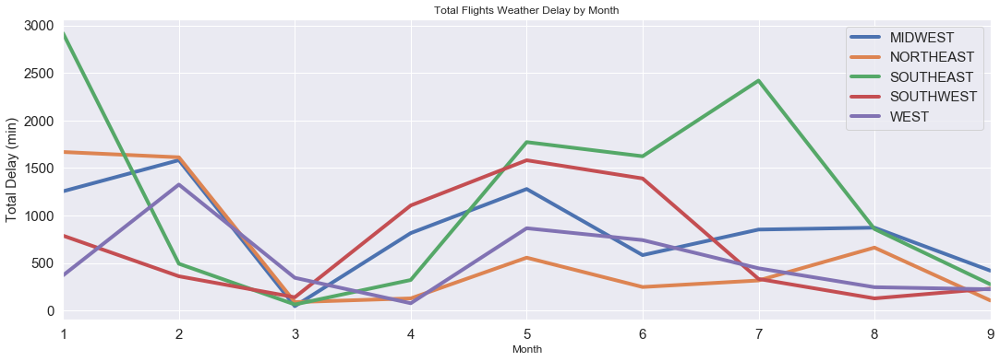

In [227]:
ax2 = new.groupby(['Month','Region']).sum().unstack(1).plot(kind='line',figsize=(18,6),fontsize=15,legend=False,title='Total Flights Weather Delay by Month',lw=4)
ax2.set_ylabel('Total Delay (min)',fontsize=15)
# plt.legend(ax[:8],['1','2','3','4','5','6','7','8','9'])
h,l = ax2.get_legend_handles_labels()
ax2.legend(h[:5],['MIDWEST','NORTHEAST','SOUTHEAST','SOUTHWEST','WEST' ], loc='best', fontsize=15)
figure2 = ax2.get_figure()
figure2.savefig("Total_Flights_Weather_Delay_by_Month.png")


In [202]:
new.groupby(['Region','Month']).mean()

WeatherDelay
Region    Month              
midwest   1         24.607843
          2         63.320000
          3         11.250000
          4         58.214286
          5         85.266667
          6         41.642857
          7         53.250000
          8         79.272727
          9         69.833333
northeast 1        278.166667
          2        268.833333
          3         22.000000
          4         42.333333
          5         92.666667
          6         41.166667
          7         45.142857
          8         73.555556
          9         35.000000
southeast 1        365.125000
          2         98.400000
          3         21.000000
          4         64.200000
          5        104.294118
          6         56.000000
          7         73.363636
          8         50.470588
          9         55.000000
southwest 1        157.600000
          2         90.000000
          3         17.375000
          4         92.166667
          5         71.909091
          6         73.157895
          7         55.333333
          8         21.166667
          9         46.000000
west      1         61.500000
          2        110.500000
          3         68.800000
          4         38.000000
          5         96.222222
          6         41.166667
          7         63.428571
          8         35.000000
          9         37.166667

In [201]:
new_gb.mean()

,WeatherDelay
Month,
1,92.131579
2,103.346154
3,28.291667
4,67.916667
5,87.768116
6,53.313953
7,63.260870
8,55.280000
9,50.080000


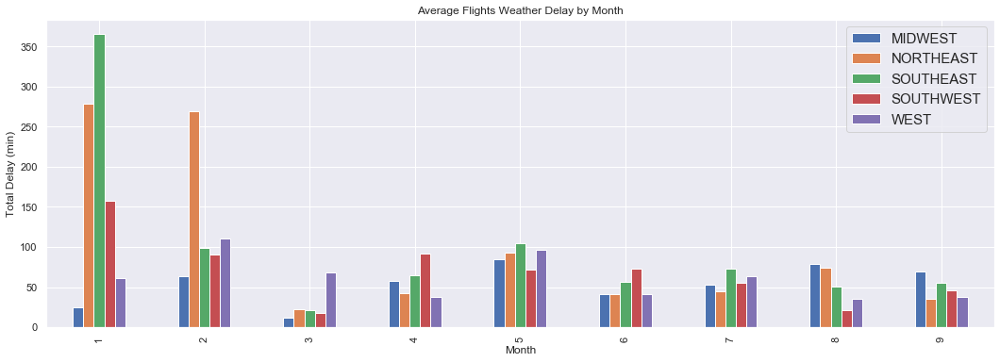

In [214]:
ax3 = new.groupby(['Month','Region']).mean().unstack(1).plot(kind='bar',figsize=(18,6),legend=False,title='Average Flights Weather Delay by Month')
ax3.set_ylabel('Total Delay (min)')
# plt.legend(ax[:8],['1','2','3','4','5','6','7','8','9'])
h,l = ax3.get_legend_handles_labels()
ax3.legend(h[:5],['MIDWEST','NORTHEAST','SOUTHEAST','SOUTHWEST','WEST' ], loc='best', fontsize=15)
figure3 = ax3.get_figure()